# Feature Engineering


In [0]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import pyspark
from pyspark.rdd import RDD
from pyspark.sql import Row, DataFrame
from pyspark.sql.types import NumericType
from pyspark.sql import functions as F

# Read data
otpw = spark.read.parquet("dbfs:/student-groups/Group_4_1/otpw_5Y_checkpoint_3_3/")
otpw = otpw.withColumn("IS_DEP_DELAY", F.when(F.col("DEP_DELAY_GROUP")<=0, 0).otherwise(1)) # Target Variable
print("Count rows:", otpw.count(), " / columns:", len(otpw.columns))
display(otpw.limit(5))

Count rows: 30365689  / columns: 57


ORIGIN,ts_hour,HourlyPrecipitation,HourlySeaLevelPressure,HourlySkyConditions,DEP_DELAY_NEW,DEP_DELAY,DEP_DELAY_GROUP,DEP_TIME,HourlyWetBulbTemperature,HourlyStationPressure,HourlyWindDirection,HourlyWindSpeed,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyDryBulbTemperature,TAIL_NUM,HourlyVisibility,CRS_ARR_TIME,DEP_TIME_BLK,DIVERTED,CANCELLED,QUARTER,OP_CARRIER_AIRLINE_ID,FL_DATE,DAY_OF_WEEK,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,CRS_DEP_TIME,OP_CARRIER_FL_NUM,dest_airport_lat,dest_region,dest_type,ELEVATION,LONGITUDE,LATITUDE,DATE,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,NAME,STATION,DISTANCE_GROUP,DISTANCE,CRS_ELAPSED_TIME,MONTH,origin_region,origin_type,origin_iata_code,dest_airport_lon,dest_iata_code,origin_airport_lon,origin_airport_lat,ts,HourlyAltimeterSetting,IS_DEP_DELAY
IAD,2015-01-01T23:00:00Z,0.00,30.1,FEW:02 180 SCT:04 250,58.0,58.0,3,2303,29,29.75,360,7,64,22,33,N833AS,10.00,2321,2200-2259,0.0,0.0,1,20366,2015-01-01,4,1,12264,10529,2205,5756,41.9,US-CT,large_airport,88.4,-77.44728,38.93486,2015-01-01T23:52:00,2015-01-02T01:05:00,2015-01-01T23:05:00,2015-01-02T03:05:00,"WASHINGTON DULLES INTERNATIONAL AIRPORT, VA US",72403093738,2,326.0,76.0,1,US-DC,large_airport,IAD,-72.7,BDL,-77.4,38.9,2015-01-01T23:52:00Z,30.1,1
TYS,2015-01-05T15:00:00Z,0.00,30.53,FEW:02 250,90.0,90.0,6,1604,32,29.45,180,6,48,20,38,N11165,10.00,1605,1400-1459,0.0,0.0,1,20366,2015-01-05,1,5,15412,12264,1434,6181,38.9,US-DC,large_airport,293.2,-83.9858,35.8181,2015-01-05T15:53:00,2015-01-05T17:34:00,2015-01-05T15:34:00,2015-01-05T19:34:00,"KNOXVILLE AIRPORT, TN US",72326013891,2,419.0,91.0,1,US-TN,large_airport,TYS,-77.4,IAD,-84.0,35.8,2015-01-05T15:53:00Z,30.51,1
LAS,2015-01-08T03:00:00Z,0.00,30.06,FEW:02 250,0.0,-4.0,-1,2337,42,27.81,200,10,48,31,50,N505NK,10.00,705,2300-2359,0.0,0.0,1,20416,2015-01-07,3,7,12889,10821,2341,696,39.2,US-MD,large_airport,664.5,-115.1634,36.0719,2015-01-08T03:56:00,2015-01-08T05:41:00,2015-01-08T03:41:00,2015-01-08T07:41:00,"MCCARRAN INTERNATIONAL AIRPORT, NV US",72386023169,9,2106.0,264.0,1,US-NV,large_airport,LAS,-76.7,BWI,-115.2,36.1,2015-01-08T03:56:00Z,30.1,0
HSV,2015-01-10T16:00:00Z,0.00,30.48,FEW:02 250,0.0,-8.0,-1,1439,29,29.76,000,0,27,7,38,N905MQ,10.00,1700,1400-1459,0.0,0.0,1,20398,2015-01-10,6,10,12217,11298,1447,3055,32.9,US-TX,large_airport,190.2,-86.7869,34.6441,2015-01-10T16:53:00,2015-01-10T18:47:00,2015-01-10T16:47:00,2015-01-10T20:47:00,"HUNTSVILLE INTNL AIRPORT, AL US",72323003856,3,603.0,133.0,1,US-AL,large_airport,HSV,-97.0,DFW,-86.8,34.6,2015-01-10T16:53:00Z,30.46,0
DAL,2015-01-16T21:00:00Z,0.00,30.12,FEW:02 230 SCT:04 280,233.0,233.0,12,2313,44,29.59,180,9,64,37,49,N15572,10.00,2028,1900-1959,0.0,0.0,1,20366,2015-01-16,5,16,11259,12266,1920,5949,30.0,US-TX,large_airport,134.1,-96.8555,32.8519,2015-01-16T21:53:00,2015-01-16T23:20:00,2015-01-16T21:20:00,2015-01-17T01:20:00,"DALLAS FAA AIRPORT, TX US",72258013960,1,216.0,68.0,1,US-TX,large_airport,DAL,-95.4,IAH,-96.9,32.9,2015-01-16T21:53:00Z,30.12,1


## 1. Weather Feature - Hourly Sky Conditions

`HourlySkyConditions` is an informative feature because sky conditions directly influence airport operations and the likelihood of departure delays. However, this variable is difficult to use in its raw form: each observation often contains multiple cloud layers concatenated into a single string. A single record can report up to 3 cloud layers with different coverage codes and base heights, for instance, "SCT020 BKN050 OVC100".

To make this variable usable for analysis, we first parsed the string using regular expressions and extracted each cloud layer into separate columns. The coverage codes themselves carry specific meanings. A reference summary is shown below.

| Coverage Code | Coverage Code Meaning | Layer Amount  |Three Digits Meaning |   Category     |
|:-------------:|:----------------------|:-------------:|---------------------|:---------------|
|      CLR      |all clear sky          |      00       |none expected        | clear sky      |
|      FEW      |few clouds             |      01-02    |cloud base height    | partly cloudy  |
|      SCT      |scattered clouds       |      03-04    |cloud base height    | partly cloudy  |
|      BKN      |broken clouds          |      05-07    |cloud base height    | mostly cloudy  |
|      OVC      |overcast               |      08       |cloud base height    | cloudy         |
|      VV       |obscured sky           |      09       |vertical visibility  | obscured       |
|      10       |partially obscured sky |      x        |         x           | obscured       |


According to [LCD documentation](https://www.ncei.noaa.gov/pub/data/cdo/documentation/LCD_documentation.pdf), climatologists traditionally determine the “overall” sky condition using the last, or highest, cloud layer. For example, in `SCT020 BKN050 OVC100`, the overall condition is OVC (overcast) because the ten-thousand-foot layer is the highest. However, this convention is not ideal for predicting flight delays. Operationally, the lowest significant cloud layer has the greatest impact on pilot visibility, runway operations, and aircraft separation. A higher layer with lighter coverage (e.g., SCT or FEW) does not mitigate the effect of a lower layer with heavier coverage (e.g., BKN or OVC). Using the highest layer would therefore introduce noise into the model and dilute the predictive strength of the feature.<br>
Therefore, we defined the overall operational sky condition as the lowest non-CLR layer in the report. This approach aligns with aviation impact rather than climatological convention. Finally, the resulting coverage codes into six intuitive categories: (clear sky, partly cloudy, mostly cloudy, cloudy, obscured, unknown). Reducing the classes in this way improves interpretability while minimizing noise in the downstream ML model.

### Notes:

Standard form: ccc-ll-xxx where xxx represents the base height of the cloud, in hundred feet.

The highest cloud layer (Layer 3):
- Does not affect runway visual range
- Does not determine IFR/VFR conditions
- Does not affect instrument approach minimums
- Does not materially slow departures or arrivals
- Is often irrelevant (e.g., cirrus clouds at 25,000 ft)
- LCD uses the third layer only for “full sky state” in climatological summarization, not for operational performance modeling.

Therefore, we will use the lowest significant layer when determing overall sky condition.<br>
- Ceiling = lowest BKN/OVC/VV layer height
- FEW020 BKN080: 
    - Lowest layer: FEW020
    - But sky condition is BKN, not FEW
    - Because BKN080 is the first layer in the list that qualifies as a ceiling definition
    - The “last layer” for determining sky state → BKN080
- SCT015 SCT030 OVC100
    - The “last layer” for sky condition → OVC100
    - Even though it’s the highest, it’s the layer that defines the sky as overcast.
- BKN005 SCT200
    - Sky condition = BKN
    - “Last layer” = BKN005
    - Because it's the lowest layer obscuring most of the sky.

In [0]:
# Look at CLR, VV, and 10

display(otpw.select("HourlySkyConditions").limit(10))

HourlySkyConditions
FEW:02 18 FEW:02 70
CLR:00
OVC:08 5
OVC:08 4
FEW:02 95 SCT:04 120 BKN:07 200
SCT:04 200 SCT:04 250
FEW:02 75
SCT:04 250
OVC:08 4
FEW:02 3


VV (Overcast) always has only one layer reported because of bad visibility and no point to observe other layers

In [0]:
display(otpw.filter(otpw.HourlySkyConditions.contains("VV")).select("HourlySkyConditions").distinct())

HourlySkyConditions
VV:09 17
VV:09 4
VV:09 19
VV:09 16
VV:09 20
VV:09 10
VV:09 1
VV:09 8
VV:09 0
VV:09 2


In [0]:
display(otpw.filter(otpw.HourlySkyConditions.contains("CLR")).select("HourlySkyConditions").distinct())

HourlySkyConditions
CLR:00
SCT:04s 95s CLR:00
FEW:02 150 SCT:04 250 CLR:00
* CLR:00
SCT:04s 45s BKN:07s 100s CLR:00
SCT:04s 26s CLR:00
SCT:04s 60s CLR:00
FEW:02 100 BKN:07 250 CLR:00
SCT:04s 30s CLR:00
FEW:02s 50s SCT:04s 85s CLR:00


In [0]:
display(otpw.filter(otpw.HourlySkyConditions.contains("10")).select("HourlySkyConditions").distinct())

HourlySkyConditions
FEW:02 110 SCT:04 160 BKN:07 190
FEW:02 100 BKN:07 160 BKN:07 220
SCT:04 100 BKN:07 150 BKN:07 200
FEW:02 110 OVC:08 200
FEW:02 40 BKN:07 180 BKN:07 210
FEW:02 80 SCT:04 120 BKN:07 210
SCT:04 110 SCT:04 180
FEW:02 24 BKN:07 90 BKN:07 210
SCT:04 45 SCT:04 100 SCT:04 250
FEW:02 15 OVC:08 110


In [0]:
from pyspark.sql import functions as F

# strict regex accepted by Spark
pattern = r"^(CLR|FEW|SCT|BKN|OVC|VV|10):(\d{2})(?:[ ]+(\d{1,3}))?(?:[ ]+(CLR|FEW|SCT|BKN|OVC|VV|10):(\d{2})(?:[ ]+(\d{1,3}))?)?(?:[ ]+(CLR|FEW|SCT|BKN|OVC|VV|10):(\d{2})(?:[ ]+(\d{1,3}))?)?$"


otpw = (
    otpw.withColumn("is_parsable", F.col("HourlySkyConditions").rlike(pattern))

    .withColumn("l1_ccc",    F.regexp_extract("HourlySkyConditions", pattern, 1))
    .withColumn("l1_ll",     F.regexp_extract("HourlySkyConditions", pattern, 2))
    .withColumn("l1_height", F.regexp_extract("HourlySkyConditions", pattern, 3))

    .withColumn("l2_ccc",    F.regexp_extract("HourlySkyConditions", pattern, 4))
    .withColumn("l2_ll",     F.regexp_extract("HourlySkyConditions", pattern, 5))
    .withColumn("l2_height", F.regexp_extract("HourlySkyConditions", pattern, 6))

    .withColumn("l3_ccc",    F.regexp_extract("HourlySkyConditions", pattern, 7))
    .withColumn("l3_ll",     F.regexp_extract("HourlySkyConditions", pattern, 8))
    .withColumn("l3_height", F.regexp_extract("HourlySkyConditions", pattern, 9))
    
)

otpw = otpw.replace({"": None}, subset=[
    "l1_ccc","l1_ll","l1_height",
    "l2_ccc","l2_ll","l2_height",
    "l3_ccc","l3_ll","l3_height"
])

# Map ccc to a sky category, but CLR becomes NULL since it is not significant
def sky_condition_expr(ccc_col):
    return (
        F.when(ccc_col == "FEW", "partly cloudy")
         .when(ccc_col == "SCT", "partly cloudy")
         .when(ccc_col == "BKN", "mostly cloudy")
         .when(ccc_col == "OVC", "cloudy")
         .when(ccc_col == "VV",  "obscured")
         .when(ccc_col == "10",  "obscured")
         .otherwise(None)        # CLR → not significant
    )

otpw = (
    otpw
    .withColumn("l1_sig", sky_condition_expr(F.col("l1_ccc")))
    .withColumn("l2_sig", sky_condition_expr(F.col("l2_ccc")))
    .withColumn("l3_sig", sky_condition_expr(F.col("l3_ccc")))
)

# -----------------------------
# Compute overall_sky_condition:
#  - IF any significant layer exists → lowest significant layer
#  - ELSE IF all layers are CLR → "clear sky"
# -----------------------------
otpw = otpw.withColumn(
    "overall_sky_condition",
    F.when(
        # all layers are CLR
        (F.col("l1_ccc") == "CLR") &
        ((F.col("l2_ccc").isNull()) | (F.col("l2_ccc") == "CLR")) &
        ((F.col("l3_ccc").isNull()) | (F.col("l3_ccc") == "CLR")),
        "clear sky"
    )
    .otherwise(
        F.coalesce("l1_sig", "l2_sig", "l3_sig")  # lowest significant layer
    )
)

# # Use LCD definition
# otpw = otpw.withColumn(
#     "overall_sky_condition",
#     F.when(
#         # all layers are CLR
#         (F.col("l1_ccc") == "CLR") &
#         ((F.col("l2_ccc").isNull()) | (F.col("l2_ccc") == "CLR")) &
#         ((F.col("l3_ccc").isNull()) | (F.col("l3_ccc") == "CLR")),
#         "clear sky"
#     )
#     .otherwise(
#         F.coalesce("l3_sig", "l2_sig", "l1_sig")  # lowest significant layer
#     )
# )

otpw = otpw.fillna("Unknown", subset=["overall_sky_condition"])
display(otpw.select("HourlySkyConditions",
                    "l1_sig","l2_sig","l3_sig",
                    "overall_sky_condition"
                    ).limit(1000))
otpw = otpw.drop("HourlySkyConditions", "is_parsable",
                "l1_ccc","l1_ll","l1_height",
                "l2_ccc","l2_ll","l2_height",
                "l3_ccc","l3_ll","l3_height",
                "l1_sig","l2_sig","l3_sig"
                )
otpw = otpw.withColumnRenamed("overall_sky_condition", "HourlySkyConditions")


HourlySkyConditions,l1_sig,l2_sig,l3_sig,overall_sky_condition
FEW:02 18 FEW:02 70,partly cloudy,partly cloudy,null,partly cloudy
CLR:00,null,null,null,clear sky
OVC:08 5,cloudy,null,null,cloudy
OVC:08 4,cloudy,null,null,cloudy
FEW:02 95 SCT:04 120 BKN:07 200,partly cloudy,partly cloudy,mostly cloudy,partly cloudy
SCT:04 200 SCT:04 250,partly cloudy,partly cloudy,null,partly cloudy
FEW:02 75,partly cloudy,null,null,partly cloudy
SCT:04 250,partly cloudy,null,null,partly cloudy
OVC:08 4,cloudy,null,null,cloudy
FEW:02 3,partly cloudy,null,null,partly cloudy


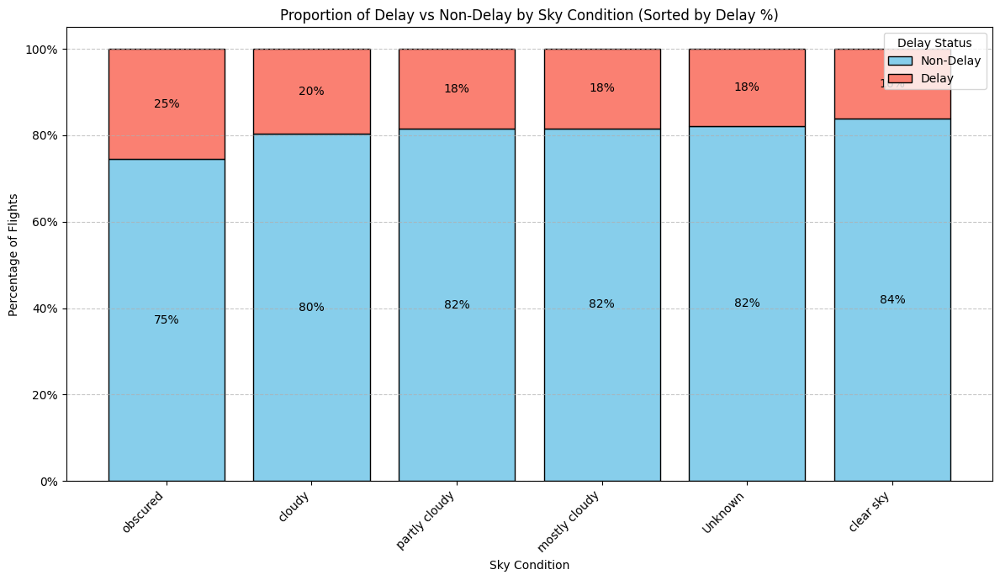

In [0]:
sky_delay_dist = (
    otpw.select("HourlySkyConditions", "IS_DEP_DELAY")
        .groupBy("HourlySkyConditions", "IS_DEP_DELAY")
        .count()
        .toPandas() # Convert to Pandas DataFrame for Matplotlib plotting
)

# --- 2. PANDAS TRANSFORMATION ---
# Pivot for plotting
sky_delay_pivot = sky_delay_dist.pivot(
    index="HourlySkyConditions", 
    columns="IS_DEP_DELAY", 
    values="count"
).fillna(0)

# Rename columns and calculate percentages
sky_delay_pivot.columns = ["Non-Delay", "Delay"]
sky_delay_pivot["Total"] = sky_delay_pivot.sum(axis=1)
sky_delay_pivot["Delay_Percent"] = (sky_delay_pivot["Delay"] / sky_delay_pivot["Total"])
sky_delay_pivot["NonDelay_Percent"] = (sky_delay_pivot["Non-Delay"] / sky_delay_pivot["Total"])

# Sort by Delay percentage (highest delay first)
sky_delay_pivot = sky_delay_pivot.sort_values(by="Delay_Percent", ascending=False)

# --- 1. DEFINE VARIABLES FOR PLOTTING ---
categories = sky_delay_pivot.index
non_delay = sky_delay_pivot["NonDelay_Percent"]
delay = sky_delay_pivot["Delay_Percent"]

# --- 2. STACKED BAR CHART WITH LABELS ---
plt.figure(figsize=(12, 7))

# Plot the Non-Delay percentage (Base/Bottom)
bar_bottom = plt.bar(
    categories,
    non_delay,
    label="Non-Delay",
    color="skyblue",
    edgecolor='black'
)

# Plot the Delay percentage (Top)
bar_top = plt.bar(
    categories,
    delay,
    label="Delay",
    color="salmon",
    bottom=non_delay, 
    edgecolor='black'
)

# --- 3. ADD PERCENTAGE LABELS ---

# Loop through each bar group to add text labels
for i, condition in enumerate(categories):
    
    # 3a. Label for Non-Delay (Bottom - Blue Section)
    # Position the text horizontally in the middle of the bar (i)
    # Position the text vertically at the center of the 'Non-Delay' segment (height/2)
    non_delay_value = non_delay.iloc[i]
    if non_delay_value > 0.05: # Only show label if the segment is large enough
        plt.text(
            x=i, 
            y=non_delay_value / 2, 
            s=f'{non_delay_value:.0%}', # Format as percentage
            ha='center', 
            va='center',
            color='black',
            fontsize=10
        )

    # 3b. Label for Delay (Top - Red/Salmon Section)
    # Position the text vertically at the center of the 'Delay' segment:
    # (bottom of segment) + (segment height / 2)
    delay_value = delay.iloc[i]
    if delay_value > 0.05: # Only show label if the segment is large enough
        plt.text(
            x=i, 
            y=non_delay_value + (delay_value / 2), 
            s=f'{delay_value:.0%}', # Format as percentage
            ha='center', 
            va='center',
            color='black',
            fontsize=10
        )

# --- 4. FINALIZE CHART APPEARANCE ---
plt.xlabel("Sky Condition")
plt.ylabel("Percentage of Flights")
plt.title("Proportion of Delay vs Non-Delay by Sky Condition (Sorted by Delay %)")
plt.xticks(rotation=45, ha='right')
plt.gca().yaxis.set_major_formatter(lambda x, _: f"{x:.0%}")
plt.legend(loc='upper right', title="Delay Status")
plt.grid(axis='y', linestyle='--', alpha=0.7) # Optional: Add gridlines
plt.tight_layout()
plt.show()

## 2. Time-Based Features

### Create Cyclical Encoding Time Based Features For Daily Patterns

From one year of EDA, we observed that the the rate of flight delay follows a cyclical pattern throughout a day, where the rate climbs up during the daytime, reaches the peak at around 8:30 pm, starts to drop, and repeats. We believe this daily cyclical pattern persists throughout all time frames. Therefore, we will encode departure time with sine and cosine functions to capture this pattern.

The Medium Ariticle about Cyclical Encoding: https://medium.com/@indradeep.chatterjee/cyclic-encoding-in-machine-learning-a-practical-guide-with-code-and-intuition-049846419ccb

Previous EDA shows that the delay rate follows a cyclical pattern. The delay rate fluctuates significantly during the early morning hours. Then the delay propagates through the network, and the rate increases until it peaks around 8:30-9:00 PM. After that, the delay rate declines gradually. The pattern repeats and time-of-day is circular, but the linear numeric features (e.g., hour = 23 vs hour = 0) incorrectly suggest that 23 and 0 are far apart, when in reality they represent adjacent moments. To address this, we encode time-of-day using the sine and cosine transformation, scaled by the total number of minutes in a day (1440).

In [0]:
otpw = (otpw
    # .sample(withReplacement=False, fraction=0.3, seed=42) # Sample 30% of the data for Time-Based Features
    .withColumn("CRS_DEP_TIME_PADDED", F.lpad(F.col("CRS_DEP_TIME").cast("string"), 4, "0"))
    .withColumn("CRS_DEP_TIME_HOUR", F.substring(F.col("CRS_DEP_TIME_PADDED"), 1, 2).cast("int"))
    .withColumn("CRS_DEP_TIME_MIN", F.substring(F.col("CRS_DEP_TIME_PADDED"), 3, 2).cast("int"))
    .withColumn("CRS_DEP_TIME_FMT", F.concat_ws(":", 
            F.lpad(F.col("CRS_DEP_TIME_HOUR").cast("string"), 2, "0"), 
            F.lpad(F.col("CRS_DEP_TIME_MIN").cast("string"), 2, "0"))
                )
    
    # Group into 30 minute buckets for smoother visualization
    .withColumn("CRS_DEP_HALF_HOUR", (F.col("CRS_DEP_TIME_HOUR") * 2 + (F.col("CRS_DEP_TIME_MIN") / 30).cast("int")).cast("int"))
    .withColumn("CRS_DEP_BUCKET_LABEL", F.concat_ws(":",
            F.lpad((F.floor(F.col("CRS_DEP_HALF_HOUR") / 2)).cast("string"), 2, "0"),
            F.when((F.col("CRS_DEP_HALF_HOUR") % 2) == 0, F.lit("00")).otherwise(F.lit("30"))
            )
        )
    
    # Cyclical encoding
    .withColumn("CRS_DEP_MINUTES", F.col("CRS_DEP_TIME_HOUR") * 60 + F.col("CRS_DEP_TIME_MIN"))
    .withColumn("CRS_DEP_SIN",
        F.sin(2 * np.pi * F.col("CRS_DEP_MINUTES") / 1440)
        )
    .withColumn("CRS_DEP_COS",
        F.cos(2 * np.pi * F.col("CRS_DEP_MINUTES") / 1440)
        )
    )

### Visualization for CRS_DEP_SIN and CRS_DEP_COS

In [0]:
## Average Half-Hourly Delay Time Series (by Local Time)
duration = "5 Year"

df = (
    otpw.groupBy("CRS_DEP_BUCKET_LABEL")
      .agg(F.mean("IS_DEP_DELAY").alias("mean_IS_DEP_DELAY"))
      .orderBy("CRS_DEP_BUCKET_LABEL")
      .toPandas()
)

## CRS_DEP_SIN and CRS_DEP_COS
# Aggregate for smoother plot
df_plot = (
    otpw.groupBy("CRS_DEP_TIME_PADDED", "CRS_DEP_MINUTES")
        .agg(
            F.mean("CRS_DEP_SIN").alias("CRS_DEP_SIN"),
            F.mean("CRS_DEP_COS").alias("CRS_DEP_COS")
        )
        .orderBy("CRS_DEP_MINUTES")
        .toPandas()
)

display(df_plot)

CRS_DEP_TIME_PADDED,CRS_DEP_MINUTES,CRS_DEP_SIN,CRS_DEP_COS
0001,1,0.00436330928474657,0.9999904807207344
0002,2,0.008726535498373935,0.9999619230641713
0003,3,0.013089595571344438,0.9999143275740072
0004,4,0.017452406437283515,0.9998476951563912
0005,5,0.02181488503456116,0.9997620270799102
0006,6,0.02617694830787315,0.9996573249755571
0007,7,0.030538513209822656,0.9995335908367129
0008,8,0.03489949670250096,0.9993908270190961
0009,9,0.039259815759068596,0.9992290362407226
0010,10,0.04361938736533598,0.9990482215818586


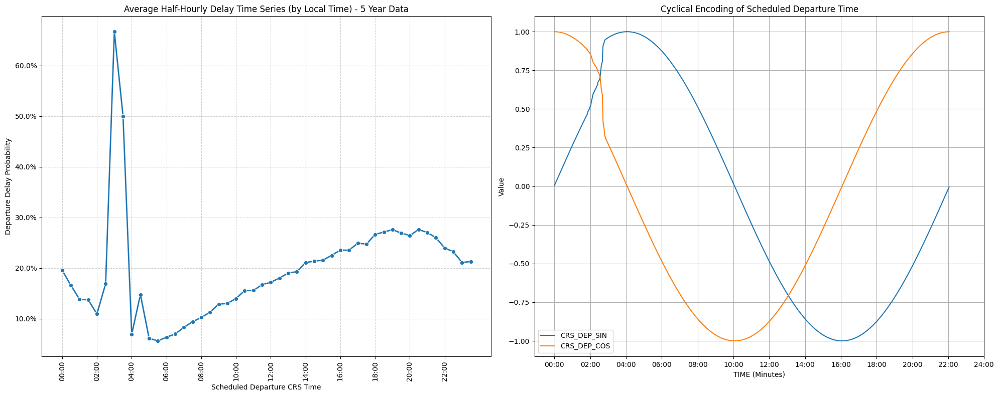

In [0]:
import matplotlib.ticker as mticker

duration = "5 Year"

# 1. Set up the figure for side-by-side plots
fig, ax = plt.subplots(1, 2, figsize=(20, 8))

# 2. Plot 1: Average Half-Hourly Delay Time Series (on ax[0])
sns.lineplot(
    data=df,
    x="CRS_DEP_BUCKET_LABEL",
    y="mean_IS_DEP_DELAY",
    marker="o",
    linewidth=2,
    ax=ax[0]
)

# Set x-ticks for better readability (every 4th = 2 hours)
ax[0].set_xticks(df["CRS_DEP_BUCKET_LABEL"][::4])
ax[0].tick_params(axis='x', rotation=90)
ax[0].set_xlabel("Scheduled Departure CRS Time")
ax[0].set_ylabel("Departure Delay Probability")
ax[0].set_title(f"Average Half-Hourly Delay Time Series (by Local Time) - {duration} Data")

# Custom formatter function for percentage on the y-axis
def percentage_formatter(x, pos):
    return f"{x:.1%}"

ax[0].yaxis.set_major_formatter(mticker.FuncFormatter(percentage_formatter))
ax[0].grid(True, linestyle="--", alpha=0.6)

# 3. Plot 2: CRS_DEP_SIN and CRS_DEP_COS (on ax[1])
ax[1].plot(df_plot['CRS_DEP_TIME_PADDED'], df_plot['CRS_DEP_SIN'], label='CRS_DEP_SIN')
ax[1].plot(df_plot['CRS_DEP_TIME_PADDED'], df_plot['CRS_DEP_COS'], label='CRS_DEP_COS')

ax[1].set_xlabel('TIME (Minutes)')
ax[1].set_ylabel('Value')
ax[1].set_title('Cyclical Encoding of Scheduled Departure Time')

# --- NEW: Set 2-hour ticks (120 minutes) on the x-axis ---
two_hour_ticks = list(range(0, 1441, 120))              # 0, 120, 240, ..., 1440
two_hour_labels = [f"{h:02d}:00" for h in range(0, 25, 2)]  # 00:00, 02:00, ..., 24:00

ax[1].set_xticks(two_hour_ticks)
ax[1].set_xticklabels(two_hour_labels)

ax[1].legend()
ax[1].grid(True)

# 4. Final adjustments and display
plt.tight_layout()
plt.show()


### Portion of Samples in Every 30 Minute Bucket

CRS_DEP_BUCKET_LABEL,Sample_Count,Delay_Count,Sample_Percent
00:00,23614,4617,7.776540160178813E-4
00:30,53105,8793,0.001748848840544998
01:00,15837,2187,5.215425870955867E-4
01:30,8632,1182,2.8426820810817106E-4
02:00,1603,175,5.278984448533343E-5
02:30,2078,351,6.843249958859818E-5
03:00,6,4,1.975914328833441E-7
03:30,4,2,1.3172762192222938E-7
04:00,29,2,9.550252589361632E-7
04:30,427,63,1.4061923640197987E-5


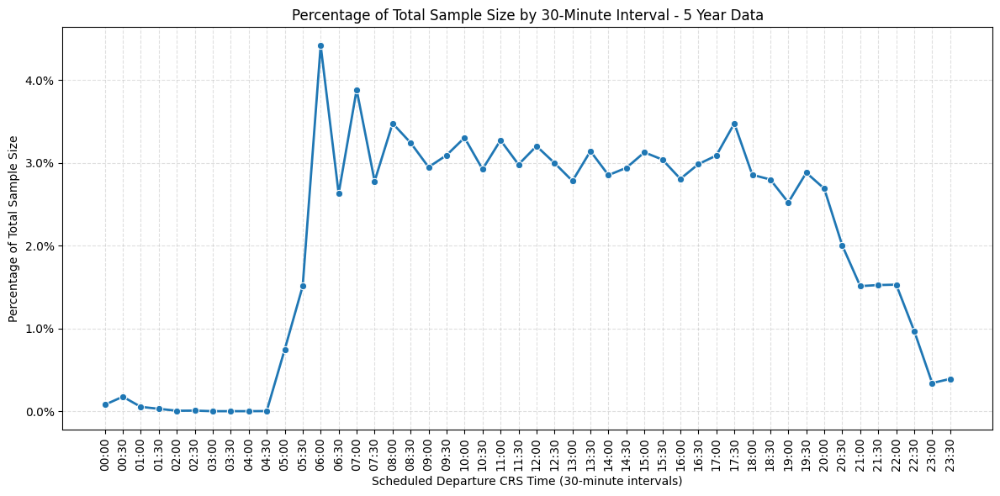

In [0]:
# Break into half hour bucket
total_count = otpw.count()

df_halfhour_pct = (
    otpw.groupBy("CRS_DEP_BUCKET_LABEL")
      .agg(
          F.count("*").alias("Sample_Count"),
          F.sum("IS_DEP_DELAY").alias("Delay_Count"),
          (F.count("*") / total_count).alias("Sample_Percent")
          )
      .orderBy("CRS_DEP_BUCKET_LABEL")
      .toPandas()
)
display(df_halfhour_pct)

# Visualization
plt.figure(figsize=(12, 6))
sns.lineplot(
    data=df_halfhour_pct,
    x="CRS_DEP_BUCKET_LABEL",
    y="Sample_Percent",
    marker="o",
    linewidth=2
)

plt.xticks(rotation=90)
plt.xlabel("Scheduled Departure CRS Time (30-minute intervals)")
plt.ylabel("Percentage of Total Sample Size")
plt.title(f"Percentage of Total Sample Size by 30-Minute Interval - {duration} Data")
plt.gca().yaxis.set_major_formatter(lambda x, _: f"{x:.1%}")
plt.grid(True, linestyle="--", alpha=0.4)
plt.tight_layout()
plt.show()



### Hypothesis Test

In [0]:
import statsmodels.api as sm

# Sample with only 10% data
pdf = otpw.select("CRS_DEP_SIN", "CRS_DEP_COS", "IS_DEP_DELAY").toPandas()

X = pdf[["CRS_DEP_SIN", "CRS_DEP_COS"]]
X = sm.add_constant(X)   # adds intercept
y = pdf["IS_DEP_DELAY"]

# Construct Model
logit_model = sm.Logit(y, X)

# Fit the model
result = logit_model.fit()
print(result.summary())



Optimization terminated successfully.
         Current function value: 0.459620
         Iterations 6


Uploading artifacts:   0%|          | 0/9 [00:00<?, ?it/s]

Uploading /local_disk0/repl_tmp_data/ReplId-19b02-8ecae-a/tmphud9boz1/model/model.statsmodels:   0%|          …

                           Logit Regression Results                           
Dep. Variable:           IS_DEP_DELAY   No. Observations:             30365689
Model:                          Logit   Df Residuals:                 30365686
Method:                           MLE   Df Model:                            2
Date:                Tue, 09 Dec 2025   Pseudo R-squ.:                 0.03276
Time:                        10:09:57   Log-Likelihood:            -1.3957e+07
converged:                       True   LL-Null:                   -1.4429e+07
Covariance Type:            nonrobust   LLR p-value:                     0.000
                  coef    std err          z      P>|z|      [0.025      0.975]
-------------------------------------------------------------------------------
const          -1.6313      0.001  -2576.505      0.000      -1.633      -1.630
CRS_DEP_SIN    -0.6405      0.001   -851.674      0.000      -0.642      -0.639
CRS_DEP_COS     0.0578      0.001     66.798    

Both `CRS_DEP_SIN` and `CRS_DEP_COS` are statistically significant; however, the pseudo R squared is quite low, meaning that they only account for a small fraction of variability. Their low coefficients also indicate low practical significance. This result is expected becuase flight delay can be affected by many other reasons beside departure time. Based on the test result, we will try out the implementation of our derived variables. Below shows a visualization of `CRS_DEP_SIN` and `CRS_DEP_COS`.

### Yearly Pattern

Yearly pattern of flight delay is affected by public holidays and summer traveling seasons.


In [0]:

# # Compute daily delay rate
# df_yearly = (
#     otpw.groupBy("FL_DATE")
#         .agg(
#             F.mean("IS_DEP_DELAY").alias("delay_rate"),
#             F.max("is_weekend").alias("is_weekend"),
#             F.max("is_holiday_window").alias("is_holiday_window"),
#             F.max("is_summer_peak").alias("is_summer_peak")
#             )
#         .orderBy("FL_DATE")
# )

# pdf_yearly = df_yearly.toPandas()
# pdf_yearly["FL_DATE"] = pd.to_datetime(pdf_yearly["FL_DATE"])



# # Visualization
# plt.figure(figsize=(16,6))

# # --- Base line plot ---
# plt.plot(
#     pdf_yearly["FL_DATE"],
#     pdf_yearly["delay_rate"],
#     label="Daily Delay Rate",
#     linewidth=1.5
# )

# # --- Weekend markers (red) ---
# holiday = pdf_yearly[pdf_yearly["is_weekend"] == 1]
# plt.scatter(
#     holiday["FL_DATE"], holiday["delay_rate"],
#     s=40, marker="o", color="red", label="Weekend", edgecolors="black"
# )

# # --- Holiday window markers (orange) ---
# holiday_win = pdf_yearly[pdf_yearly["is_holiday_window"] == 1]
# plt.scatter(
#     holiday_win["FL_DATE"], holiday_win["delay_rate"],
#     s=40, marker="o", color="orange", label="Holiday Window", edgecolors="black"
# )

# # --- Summer peak markers (green) ---
# summer_peak = pdf_yearly[pdf_yearly["is_summer_peak"] == 1]
# plt.scatter(
#     summer_peak["FL_DATE"], summer_peak["delay_rate"],
#     s=40, marker="o", color="green", label="Summer Peak", edgecolors="black"
# )

# # --- Labels ---
# plt.xlabel("Date")
# plt.ylabel("Delay Rate")
# plt.title("Daily Departure Delay Rate Over One Year\n(Holiday, Holiday Window, and Summer Peak Marked)")
# plt.legend()
# plt.grid(True, alpha=0.3)
# plt.tight_layout()

# plt.show()


### Delay Rate By Airport Type

In [0]:
airport_delay = (
    otpw.groupBy('origin_type')
        .agg(F.mean("IS_DEP_DELAY").alias("DelayRate")
       )
).toPandas()

display(airport_delay)


origin_type,DelayRate
large_airport,0.18409901969120057
medium_airport,0.14530622915646615
small_airport,0.15081393474707006
seaplane_base,1.0


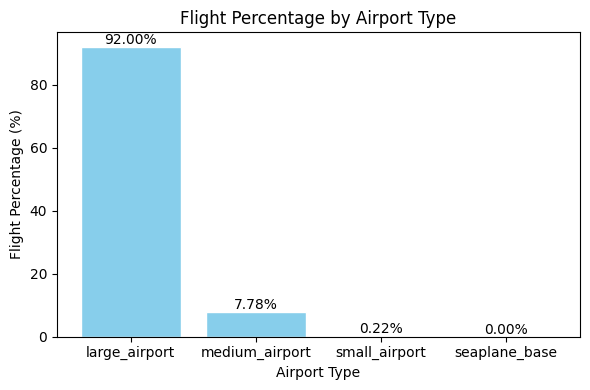

In [0]:
airport_type_dist = (
    otpw.groupBy('origin_type')
        .agg(F.count("*").alias("flightCount"),
             (F.count("*") / otpw.count()).alias("flightPercent"))
).toPandas()

labels = airport_type_dist["origin_type"].replace({1: "Large", 2: "Medium", 3: "Small", 4: "Seaplane"})
percentages = airport_type_dist['flightPercent'].apply(lambda x: round(x * 100, 2))
plt.figure(figsize=(6, 4))
bars = plt.bar(labels, percentages, color='skyblue', edgecolor='white')
plt.xlabel("Airport Type")
plt.ylabel("Flight Percentage (%)")
plt.title("Flight Percentage by Airport Type")
for bar, pct in zip(bars, percentages):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height(), f'{pct:.2f}%', ha='center', va='bottom')
plt.tight_layout()
plt.show()

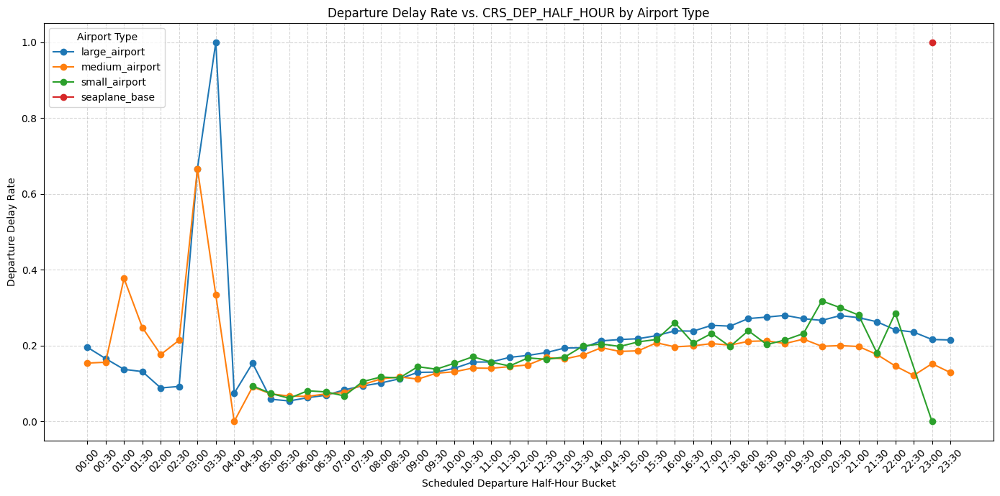

In [0]:
# Calculate mean departure delay rate by half-hour and airport type
df_type_delay = (
    otpw.groupBy("CRS_DEP_BUCKET_LABEL", "origin_type")
        .agg(F.mean("IS_DEP_DELAY").alias("mean_delay_rate"))
        .orderBy("CRS_DEP_BUCKET_LABEL", "origin_type")
        .toPandas()
)

# Map airport type codes to labels
plt.figure(figsize=(14, 7))
for v in df_type_delay["origin_type"].unique():
    subset = df_type_delay[df_type_delay["origin_type"] == v]
    plt.plot(subset["CRS_DEP_BUCKET_LABEL"], subset["mean_delay_rate"], marker="o", label=v)

plt.xlabel("Scheduled Departure Half-Hour Bucket")
plt.ylabel("Departure Delay Rate")
plt.title("Departure Delay Rate vs. CRS_DEP_HALF_HOUR by Airport Type")
plt.xticks(rotation=45)
plt.legend(title="Airport Type")
plt.grid(True, linestyle="--", alpha=0.5)
plt.tight_layout()
plt.show()

In [0]:
outlier = (
    otpw.filter(F.col("origin_type") == "seaplane_base")
    .union(
        otpw.filter(
            (F.col("CRS_DEP_BUCKET_LABEL").isin(["02:30", "03:00", "03:30", "04:00", "04:30"]))            
        )
    )
)


In [0]:

o = outlier.withColumn("DEP_DELAY_GROUP", F.col("DEP_DELAY_GROUP").cast("int")) \
            .orderBy(F.col("DEP_DELAY_GROUP"), F.desc("DEP_DELAY_GROUP"))
display(o)

ORIGIN,ts_hour,HourlyPrecipitation,HourlySeaLevelPressure,DEP_DELAY_NEW,DEP_DELAY,DEP_DELAY_GROUP,DEP_TIME,HourlyWetBulbTemperature,HourlyStationPressure,HourlyWindDirection,HourlyWindSpeed,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyDryBulbTemperature,TAIL_NUM,HourlyVisibility,CRS_ARR_TIME,DEP_TIME_BLK,DIVERTED,CANCELLED,QUARTER,OP_CARRIER_AIRLINE_ID,FL_DATE,DAY_OF_WEEK,DAY_OF_MONTH,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,CRS_DEP_TIME,OP_CARRIER_FL_NUM,dest_airport_lat,dest_region,dest_type,ELEVATION,LONGITUDE,LATITUDE,DATE,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,NAME,STATION,DISTANCE_GROUP,DISTANCE,CRS_ELAPSED_TIME,MONTH,origin_region,origin_type,origin_iata_code,dest_airport_lon,dest_iata_code,origin_airport_lon,origin_airport_lat,ts,HourlyAltimeterSetting,IS_DEP_DELAY,HourlySkyConditions,CRS_DEP_TIME_PADDED,CRS_DEP_TIME_HOUR,CRS_DEP_TIME_MIN,CRS_DEP_TIME_FMT,CRS_DEP_HALF_HOUR,CRS_DEP_BUCKET_LABEL,CRS_DEP_MINUTES,CRS_DEP_SIN,CRS_DEP_COS
IAG,2018-03-08T03:00:00Z,0.00,29.79,0.0,-17.0,-2,233,26,29.13,240,16,69,20,29,N653NK,10.00,549,0001-0559,0.0,0.0,1,20416,2018-03-08,4,8,12265,11697,250,647,26.1,US-FL,large_airport,178.3,-78.93806,43.10833,2018-03-08T03:53:00,2018-03-08T05:50:00,2018-03-08T03:50:00,2018-03-08T07:50:00,"NIAGARA FALLS INTERNATIONAL AIRPORT, NY US",72528704724,5,1176.0,179.0,3,US-NY,medium_airport,IAG,-80.2,FLL,-78.9,43.1,2018-03-08T03:53:00Z,29.76,0,partly cloudy,0250,2,50,02:50,5,02:30,170,0.6755902076156602,0.737277336810124
PBG,2019-06-18T02:00:00Z,0.00,30.01,0.0,-24.0,-2,228,50,29.73,000,0,89,49,52,N611NK,10.00,609,0001-0559,0.0,0.0,2,20416,2019-06-18,2,18,14025,11697,252,451,26.1,US-FL,large_airport,71.3,-73.46667,44.65,2019-06-18T02:53:00,2019-06-18T04:52:00,2019-06-18T02:52:00,2019-06-18T06:52:00,"PLATTSBURGH INTERNATIONAL AIRPORT, NY US",72622564776,6,1334.0,197.0,6,US-NY,medium_airport,PBG,-80.2,FLL,-73.5,44.7,2019-06-18T02:53:00Z,29.98,0,partly cloudy,0252,2,52,02:52,5,02:30,172,0.6819983600624985,0.7313537016191706
IAG,2015-07-13T02:00:00Z,0.00,29.89,0.0,-16.0,-2,222,63,29.27,100,3,87,61,65,N633NK,9.00,528,0001-0559,0.0,0.0,3,20416,2015-07-13,1,13,12265,11697,238,647,26.1,US-FL,large_airport,178.3,-78.93806,43.10833,2015-07-13T02:53:00,2015-07-13T04:38:00,2015-07-13T02:38:00,2015-07-13T06:38:00,"NIAGARA FALLS INTERNATIONAL AIRPORT, NY US",72528704724,5,1176.0,170.0,7,US-NY,medium_airport,IAG,-80.2,FLL,-78.9,43.1,2015-07-13T02:53:00Z,29.9,0,partly cloudy,0238,2,38,02:38,5,02:30,158,0.636078220277764,0.77162458338772
PBG,2019-01-26T03:00:00Z,T,30.12,0.0,-21.0,-2,229,10,29.86,010,5,88,8,11,N638NK,4.00,630,0001-0559,0.0,0.0,1,20416,2019-01-26,6,26,14025,11697,250,451,26.1,US-FL,large_airport,71.3,-73.46667,44.65,2019-01-26T03:53:00,2019-01-26T05:50:00,2019-01-26T03:50:00,2019-01-26T07:50:00,"PLATTSBURGH INTERNATIONAL AIRPORT, NY US",72622564776,6,1334.0,220.0,1,US-NY,medium_airport,PBG,-80.2,FLL,-73.5,44.7,2019-01-26T03:53:00Z,30.11,0,partly cloudy,0250,2,50,02:50,5,02:30,170,0.6755902076156602,0.737277336810124
IAG,2017-11-19T03:00:00Z,0.07,30.01,0.0,-29.0,-2,206,34,28.68,320,17,82,31,36,N619NK,1.75,532,0001-0559,0.0,0.0,4,20416,2017-11-19,7,19,12265,11697,235,647,26.1,US-FL,large_airport,178.3,-78.93806,43.10833,2017-11-19T03:40:00,2017-11-19T05:35:00,2017-11-19T03:35:00,2017-11-19T07:35:00,"NIAGARA FALLS INTERNATIONAL AIRPORT, NY US",72528704724,5,1176.0,177.0,11,US-NY,medium_airport,IAG,-80.2,FLL,-78.9,43.1,2017-11-19T03:40:00Z,29.3,0,cloudy,0235,2,35,02:35,5,02:30,155,0.6259234721840591,0.7798844830928818
PBG,2019-03-21T03:00:00Z,0.00,30.11,0.0,-16.0,-2,239,28,29.86,180,3,82,25,30,N651NK,10.00,627,0001-0559,0.0,0.0,1,20416,2019-03-21,4,21,14025,11697,255,451,26.1,US-FL,large_airport,71.3,-73.46667,44.65,2019-03-21T03:53:00,2019-03-21T04:55:00,2019-03-21T02:55:00,2019-03-21T06:55:00,"PLATTSBURGH INTERNATIONAL AIRPORT, NY US",72622564776,6,1334.0,212.0,3,US-NY,medium_airport,PBG,-80.2,FLL,-73.5,44.7,2019-03-21T03:53:00Z,30.11,0,cloudy,0255,2,55,02:55,5,0

## 3. Graph-Based Feature
Raw airport codes are nominal categorical features, which makes it difficult for a model to directly infer the relative importance or connectivity across the national flight network. Graph algorithms are good at capturing this network information. Specifically, we use PageRank to measure the relative importance of each node based on both the number and the quality of its connections. Instead of only focusing on directly connected neighbors, PageRank recursively incorporates the importance of upstream and downstream nodes to capture indirect influence across the airport network. This produces a more expressive structural variable that reflects how central an airport is within the broader air transportation system.

In [0]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import pyspark
from pyspark.rdd import RDD
from pyspark.sql import Row, DataFrame
from pyspark.sql.types import NumericType
from pyspark.sql import functions as F

# Read data
otpw = spark.read.parquet("dbfs:/student-groups/Group_4_1/otpw_5Y_checkpoint_3_3/")
otpw = otpw.withColumn("IS_DEP_DELAY", F.when(F.col("DEP_DELAY_GROUP")<=0, 0).otherwise(1)) # Target Variable

print("Count rows:", otpw.count(), " / columns:", len(otpw.columns))

Count rows: 30365689  / columns: 57


In [0]:
df_routes = (
    otpw.select("ORIGIN_AIRPORT_ID", "origin_iata_code", "origin_type", "origin_airport_lat", "origin_airport_lon",
                "DEST_AIRPORT_ID", "dest_iata_code", "dest_type", "dest_airport_lat", "dest_airport_lon",
                "DEP_DELAY", "IS_DEP_DELAY")
    .groupBy("ORIGIN_AIRPORT_ID", "origin_iata_code", "origin_type", "origin_airport_lat", "origin_airport_lon",
             "DEST_AIRPORT_ID", "dest_iata_code", "dest_type", "dest_airport_lat", "dest_airport_lon")
    .agg(F.sum("DEP_DELAY").alias("TotalDelayMins"),
         F.sum("IS_DEP_DELAY").alias("DelayFlightCount"),
         F.count("*").alias("FlightCount"),           
         )
)

display(df_routes)

ORIGIN_AIRPORT_ID,origin_iata_code,origin_type,origin_airport_lat,origin_airport_lon,DEST_AIRPORT_ID,dest_iata_code,dest_type,dest_airport_lat,dest_airport_lon,TotalDelayMins,DelayFlightCount,FlightCount
10721,BOS,large_airport,42.4,-71.0,11433,DTW,large_airport,42.2,-83.3,220324.0,3373,18002
12953,LGA,large_airport,40.8,-73.9,13930,ORD,large_airport,42.0,-87.9,814931.0,11591,55745
12953,LGA,large_airport,40.8,-73.9,14321,PWM,large_airport,43.6,-70.3,61369.0,865,3548
10693,BNA,large_airport,36.1,-86.7,14771,SFO,large_airport,37.6,-122.4,58261.0,873,2676
13930,ORD,large_airport,42.0,-87.9,11986,GRR,medium_airport,42.9,-85.5,155188.0,2740,13831
13139,LYH,medium_airport,37.3,-79.2,11057,CLT,large_airport,35.2,-81.0,18073.0,332,1895
13342,MKE,large_airport,43.0,-87.9,11433,DTW,large_airport,42.2,-83.3,78808.0,1230,9364
14492,RDU,large_airport,35.9,-78.8,11433,DTW,large_airport,42.2,-83.3,41505.0,631,5327
11433,DTW,large_airport,42.2,-83.3,11537,ELM,medium_airport,42.2,-76.9,32173.0,596,3741
13851,OKC,large_airport,35.4,-97.6,12266,IAH,large_airport,30.0,-95.4,70016.0,1228,7676


In [0]:
# Create unique airport information table
origin_airports = df_routes.select(
    F.col("ORIGIN_AIRPORT_ID").alias("Airport_ID"),
    F.col("origin_iata_code").alias("Iata_Code"),
    F.col("origin_type").alias("Airport_Type"),
    F.col("origin_airport_lat").alias("Airport_Lat"),
    F.col("origin_airport_lon").alias("Airport_Lon")
).distinct()

dest_airports = df_routes.select(
    F.col("DEST_AIRPORT_ID").alias("Airport_ID"),
    F.col("dest_iata_code").alias("Iata_Code"),
    F.col("dest_type").alias("Airport_Type"),
    F.col("dest_airport_lat").alias("Airport_Lat"),
    F.col("dest_airport_lon").alias("Airport_Lon")
).distinct()

df_airports = origin_airports.union(dest_airports).distinct()
display(df_airports)

Airport_ID,Iata_Code,Airport_Type,Airport_Lat,Airport_Lon
13230,MDT,medium_airport,40.2,-76.8
14487,RDD,medium_airport,40.5,-122.3
13433,MOT,medium_airport,48.3,-101.3
11140,CRP,large_airport,27.8,-97.5
12954,LGB,medium_airport,33.8,-118.1
11982,GRK,medium_airport,31.1,-97.8
15497,UST,medium_airport,30.0,-81.3
12402,ITO,medium_airport,19.7,-155.1
14027,PBI,large_airport,26.7,-80.1
11996,GSP,large_airport,34.9,-82.2


### EDA - Top 20 Airports by Total Flight Frequency (%)

In [0]:
# Top Departure + Arrival Airports
origin_airports = (otpw.select("ORIGIN_IATA_CODE")
                .groupBy("ORIGIN_IATA_CODE")
                .agg(F.count("*").alias("OriginFrequency"))
                .withColumnRenamed("ORIGIN_IATA_CODE", "ID"))

dest_airports = (otpw.select("DEST_IATA_CODE")
                .groupBy("DEST_IATA_CODE")
                .agg(F.count("*").alias("DestFrequency"))
                .withColumnRenamed("DEST_IATA_CODE", "ID"))

airports = (origin_airports.join(dest_airports, on="ID", how="full_outer")
            .withColumn("TotalFrequency", F.coalesce(F.col("OriginFrequency"), F.lit(0)) + F.coalesce(F.col("DestFrequency"), F.lit(0)))
            .orderBy(F.desc("TotalFrequency"))
            )

pdf_airports = airports.toPandas()
pdf_airports["Percentage"] = (pdf_airports["TotalFrequency"] / pdf_airports["TotalFrequency"].sum()) \
                                .apply(lambda x: "{:.2%}".format(x))

top = pdf_airports.head(20)


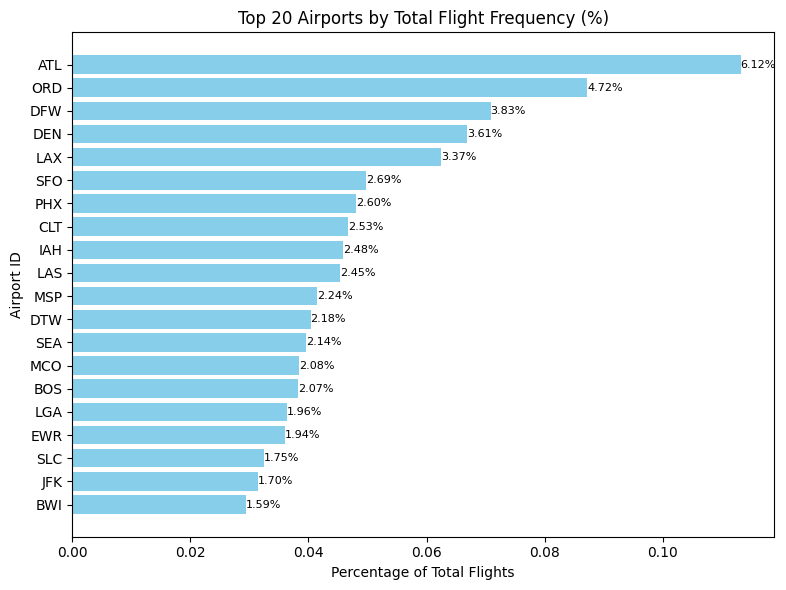

In [0]:
plt.figure(figsize=(8, 6))
plt.barh(top["ID"], top["TotalFrequency"] / top["TotalFrequency"].sum(), color="skyblue")
plt.gca().invert_yaxis()
for i, (id_, pct) in enumerate(zip(top["ID"], top["Percentage"])):
    plt.text(float(top["TotalFrequency"].iloc[i] / top["TotalFrequency"].sum()), i, pct, va='center', ha='left', fontsize=8)
plt.xlabel("Percentage of Total Flights")
plt.ylabel("Airport ID")
plt.title("Top 20 Airports by Total Flight Frequency (%)")
plt.tight_layout()
plt.show()

### Unweighted Airport Page Rank Score
This score focuses more on structural connectivity. A route with 1 flight/day has the same influence as a route with 100 flights/day on the originating airport's rank distribution. Such PageRank scores are good for identifying airports that are topologically critical (bottlenecks in the structure).


In [0]:
from graphframes import GraphFrame

def create_vertices_df(df):
    origins = df.select(
        F.col("origin_iata_code").alias("id")
        ).distinct()
    destinations = df.select(
        F.col("dest_iata_code").alias("id")
        ).distinct()
    vertices_df = origins.union(destinations).distinct()
    print(f"Total unique airports (vertices): {vertices_df.count()}")

    return vertices_df

def create_edges_df(df):
    edges_df = (
        df.groupBy("origin_iata_code", "dest_iata_code")
          .agg(
            # F.mean("DEP_DELAY").alias("AvgDelayMin"),
            # F.mean("IS_DEP_DELAY").alias("DelayRate"),
            F.count("*").alias("weight")
          )
          .withColumnRenamed("origin_iata_code", "src") # Rename for GraphFrames
          .withColumnRenamed("dest_iata_code", "dst")   # Rename for GraphFrames
        )
    print(f"Total unique routes (edges): {edges_df.count()}")
    return edges_df

def run_unweighted_pagerank(vertices_df, edges_df):
    """Constructs the graphframes GraphFrame."""

    g = GraphFrame(vertices_df, edges_df)
    g.cache()
    results = g.pageRank(
        resetProbability=0.15,
        maxIter=10
        )
    
    pagerank_scores = results.vertices.select(
        F.col("id").alias("Iata_Code"),
        F.col("pagerank").alias("Unweighted_PR_Scores")
    )
    pagerank_scores = pagerank_scores.orderBy(F.desc("Unweighted_PR_Scores"))
    print("PageRank scores successfully computed.")
    return pagerank_scores

vertices_df = create_vertices_df(otpw)
edges_df = create_edges_df(otpw)
PR_unweighted = run_unweighted_pagerank(vertices_df, edges_df)
display(PR_unweighted)

Total unique airports (vertices): 371
Total unique routes (edges): 7239
PageRank scores successfully computed.


Iata_Code,Unweighted_PR_Scores
ORD,11.065070060196813
DFW,10.662712523259072
DEN,10.26948884179876
ATL,8.785240165973828
MSP,7.119819262014851
CLT,6.752475268094909
DTW,5.981325189659848
IAH,5.9221944035494385
LAX,5.736726506667757
LAS,5.460395083693015


### Airport Page Rank Score Weighted By All 5 Year Traffic Volume
After weighting every edge by all 5 years' flight count, high volume connections are more influential in the graph structure. This means, a route with 100 flights/day has a much greater influence on the originating airport's rank distribution. This measure is better for identifying airports that are operationally critical and where a delay is likely to affect the greatest number of subsequent flights and passengers.

We first construct a directed graph in which each airport is a node, and each flight is an edge from the origin to the destination. We then assign edge weights using historical flight counts, so routes with higher traffic contribute proportionally more to the network structure. The key fields used to construct the graph are the IATA codes for each flight's origin and destination.

In [0]:
%%capture
%pip install python-igraph

In [0]:

import igraph as ig

def create_edges_pdf(df):
    edges_df = (
        df.groupBy(
                   "origin_iata_code",
                   "dest_iata_code"
                  )
          .agg(
            # F.mean("DEP_DELAY").alias("AvgDelayMin"),
            # F.mean("IS_DEP_DELAY").alias("DelayRate"),
            F.count("*").alias("weight")
          )
          .withColumnRenamed("origin_iata_code", "source")
          .withColumnRenamed("dest_iata_code", "target")
          .select("source", "target", "weight")
        ).toPandas()

    return edges_df

def run_weighted_pagerank(pdf):
    g = ig.Graph.DataFrame(edges=pdf,
                           directed=True,
                           use_vids=False)
    pagerank_scores = g.pagerank(directed=True,
                                 damping=0.85,
                                 weights=g.es["weight"])
    result = pd.DataFrame({
        'Iata_Code': g.vs['name'],
        'FlightCount_PR_Scores': pagerank_scores
    })
    return result

edges = create_edges_pdf(otpw)
PR_FlightCount = run_weighted_pagerank(edges)
display(PR_FlightCount.sort_values("FlightCount_PR_Scores", ascending=False))

Iata_Code,FlightCount_PR_Scores
ATL,0.0541878388143734
ORD,0.0453670535445899
DFW,0.03933487263719289
DEN,0.0363608009815648
LAX,0.027153468566305496
MSP,0.023269712483095246
SFO,0.02286401333374068
CLT,0.022523677496030358
IAH,0.022059251640533673
PHX,0.021638527836249297


### Join Back the Weighted and Unweighted Result

In [0]:
# Join unweighted PageRank
airports_with_unweighted_pr = df_airports.join(
    PR_unweighted,
    df_airports["Iata_Code"] == PR_unweighted["Iata_Code"],
    how="left"
).drop(PR_unweighted["Iata_Code"])

# Convert weighted PageRank pandas DataFrame to Spark DataFrame
PR_FlightCount_sdf = spark.createDataFrame(PR_FlightCount)

# Join weighted PageRank
df_airports = airports_with_unweighted_pr.join(
    PR_FlightCount_sdf,
    airports_with_unweighted_pr["Iata_Code"] == PR_FlightCount_sdf["Iata_Code"],
    how="left"
).drop(PR_FlightCount_sdf["Iata_Code"]).orderBy("FlightCount_PR_Scores", ascending=False)

display(df_airports)


Airport_ID,Iata_Code,Airport_Type,Airport_Lat,Airport_Lon,Unweighted_PR_Scores,FlightCount_PR_Scores
10397,ATL,large_airport,33.6,-84.4,8.785240165973828,0.0541878388143734
13930,ORD,large_airport,42.0,-87.9,11.065070060196813,0.0453670535445899
11298,DFW,large_airport,32.9,-97.0,10.662712523259072,0.03933487263719289
11292,DEN,large_airport,39.8,-104.7,10.26948884179876,0.0363608009815648
12892,LAX,large_airport,33.9,-118.4,5.736726506667757,0.027153468566305496
13487,MSP,large_airport,44.9,-93.2,7.119819262014851,0.023269712483095246
14771,SFO,large_airport,37.6,-122.4,4.735441698969092,0.02286401333374068
11057,CLT,large_airport,35.2,-81.0,6.752475268094909,0.022523677496030358
12266,IAH,large_airport,30.0,-95.4,5.9221944035494385,0.022059251640533673
14107,PHX,large_airport,33.4,-112.0,4.802141527737289,0.021638527836249297


### (Time Aware) Page Rank Scores Weighted By Histoical Flight Count
To avoid introducing future information into the model, we compute PageRank scores in a time-aware manner. Specifically, we group the data by year and month and calculate cumulative flight counts up to each year–month period. By recomputing the network structure incrementally at each time step, we obtain PageRank values that reflect only historical information available at that point in time to prevent any leakage from future activity. The PageRank scores are merged back to Spark based on the airport ID, year, and month.



In scenarios where a new airport appears for the first time—such as an airport that does not exist in the training period and has no prior flight history—we initialize its PageRank with a minimal baseline score. This ensures the model can handle newly introduced nodes without producing missing values, while still allowing the PageRank algorithm to update the airport’s importance dynamically as it becomes integrated into the network.

In [0]:
from pyspark.sql.window import Window
otpw = otpw.withColumn("year_month", F.date_format("FL_DATE", "yyyy-MM"))

# Aggregate MONTHLY first
monthly_edges = (
    otpw.groupBy("year_month", "ORIGIN_AIRPORT_ID", "DEST_AIRPORT_ID")
        .agg(F.count("*").alias("month_weight"))
)

# Then add a window to build cumulative weights
w = Window.partitionBy("ORIGIN_AIRPORT_ID", "DEST_AIRPORT_ID") \
          .orderBy("year_month") \
          .rowsBetween(Window.unboundedPreceding, Window.currentRow)
monthly_edges = monthly_edges.withColumn("cumulative_weight", F.sum("month_weight").over(w))

display(monthly_edges)

year_month,ORIGIN_AIRPORT_ID,DEST_AIRPORT_ID,month_weight,cumulative_weight
2015-01,10135,11433,60,60
2015-02,10135,11433,42,102
2015-03,10135,11433,50,152
2015-04,10135,11433,55,207
2015-05,10135,11433,58,265
2015-06,10135,11433,65,330
2015-07,10135,11433,64,394
2015-08,10135,11433,65,459
2015-09,10135,11433,52,511
2015-10,10135,11433,64,575


In [0]:
def create_edges_pdf(monthly_edges_df, period):
    return (
        monthly_edges_df
        .filter(F.col("year_month") == period)
        .select(
            F.col("ORIGIN_AIRPORT_ID").alias("source"),
            F.col("DEST_AIRPORT_ID").alias("target"),
            F.col("cumulative_weight").alias("weight")
        )
        .toPandas()
    )


def run_weighted_pagerank_for_period(edges_pdf, period):
    """
    spark_df: cumulative_edges (Spark DataFrame)
    period_ym: string 'YYYY-MM'
    """
    g = ig.Graph.DataFrame(edges=edges_pdf,
                           directed=True,
                           use_vids=False) 
                        
    pagerank_scores = g.pagerank(directed=True,
                                 damping=0.85,
                                 weights=g.es["weight"])
    result = pd.DataFrame({
        'year_month': period,
        'AIRPORT_ID': g.vs['name'],
        'FlightCount_PR_Scores': pagerank_scores        
    })
    return result



In [0]:
# Extract all periods
periods = otpw.select("year_month").distinct().orderBy("year_month").collect()
periods = [row.year_month for row in periods]

# Run weighted PageRank for each period
pr_list = []
for period in periods:
    edges_pdf = create_edges_pdf(monthly_edges, period)    
    if edges_pdf.empty:
        continue
    pr_df = run_weighted_pagerank_for_period(edges_pdf, period)
    pr_list.append(pr_df)
Total_PR = pd.concat(pr_list, ignore_index=True)

display(Total_PR)


year_month,AIRPORT_ID,FlightCount_PR_Scores
2015-01,10140,0.003021287935198274
2015-01,10821,0.011917988107670443
2015-01,11259,0.008559954355365464
2015-01,11292,0.03494791750902092
2015-01,12266,0.0258175501892301
2015-01,13198,0.0056814583226096485
2015-01,13232,0.011168417253800038
2015-01,13930,0.049177171430140644
2015-01,10141,5.656668361865089E-4
2015-01,13487,0.020139517230930125


#### Join Total_PR back to OTPW

In [0]:
from pyspark.sql.types import DoubleType

# Convert Total_PR to Spark DF with correct types
Total_PR_sdf = (
    spark.createDataFrame(Total_PR)
         .withColumn("AIRPORT_ID", F.col("AIRPORT_ID").cast("string"))
         .withColumn("FlightCount_PR_Scores", F.col("FlightCount_PR_Scores").cast("double"))
)

# Prepare origin PR lookup
pr_origin = Total_PR_sdf.select(
    "year_month",
    F.col("AIRPORT_ID").alias("ORIGIN_AIRPORT_ID"),
    F.col("FlightCount_PR_Scores").alias("Origin_FlightCount_PR_Scores")
)

# Join origin PR
otpw_with_pr = (
    otpw.join(
        pr_origin,
        on=["year_month", "ORIGIN_AIRPORT_ID"],
        how="left"
    )
)

# Prepare destination PR lookup
pr_dest = Total_PR_sdf.select(
    "year_month",
    F.col("AIRPORT_ID").alias("DEST_AIRPORT_ID"),
    F.col("FlightCount_PR_Scores").alias("Dest_FlightCount_PR_Scores")
)

# Join destination PR
df_final = (
    otpw_with_pr.join(
        pr_dest,
        on=["year_month", "DEST_AIRPORT_ID"],
        how="left"
    )
).drop("year_month")

display(df_final)


DEST_AIRPORT_ID,ORIGIN_AIRPORT_ID,ORIGIN,ts_hour,HourlyPrecipitation,HourlySeaLevelPressure,HourlySkyConditions,DEP_DELAY_NEW,DEP_DELAY,DEP_DELAY_GROUP,DEP_TIME,HourlyWetBulbTemperature,HourlyStationPressure,HourlyWindDirection,HourlyWindSpeed,HourlyRelativeHumidity,HourlyDewPointTemperature,HourlyDryBulbTemperature,TAIL_NUM,HourlyVisibility,CRS_ARR_TIME,DEP_TIME_BLK,DIVERTED,CANCELLED,QUARTER,OP_CARRIER_AIRLINE_ID,FL_DATE,DAY_OF_WEEK,DAY_OF_MONTH,CRS_DEP_TIME,OP_CARRIER_FL_NUM,dest_airport_lat,dest_region,dest_type,ELEVATION,LONGITUDE,LATITUDE,DATE,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,sched_depart_date_time_UTC,NAME,STATION,DISTANCE_GROUP,DISTANCE,CRS_ELAPSED_TIME,MONTH,origin_region,origin_type,origin_iata_code,dest_airport_lon,dest_iata_code,origin_airport_lon,origin_airport_lat,ts,HourlyAltimeterSetting,IS_DEP_DELAY,Origin_FlightCount_PR_Scores,Dest_FlightCount_PR_Scores
11278,11697,FLL,2015-01-04T22:00:00Z,0.00,30.26,FEW:02 18 FEW:02 70,3.0,3.0,0,2102,74,30.25,090,7,94,73,75,N266JB,10.00,2318,2000-2059,0.0,0.0,1,20409,2015-01-04,7,4,2059,80,38.8,US-DC,large_airport,3.4,-80.16217,26.07875,2015-01-04T22:53:00,2015-01-04T23:59:00,2015-01-04T21:59:00,2015-01-05T01:59:00,"FORT LAUDERDALE INTERNATIONAL AIRPORT, FL US",74783012849,4,899.0,139.0,1,US-FL,large_airport,FLL,-77.0,DCA,-80.2,26.1,2015-01-04T22:53:00Z,30.26,0,0.013245896526622447,0.01055064512798753
13930,11274,DBQ,2015-01-07T13:00:00Z,0.00,30.88,CLR:00,77.0,77.0,5,1237,-4,29.60,320,11,56,-15,-3,N653MQ,10.00,1219,1100-1159,0.0,0.0,1,20398,2015-01-07,3,7,1120,3672,42.0,US-IL,large_airport,321.9,-90.70361,42.39778,2015-01-07T13:53:00,2015-01-07T15:20:00,2015-01-07T13:20:00,2015-01-07T17:20:00,"DUBUQUE REGIONAL AIRPORT, IA US",72547094908,1,147.0,59.0,1,US-IA,large_airport,DBQ,-87.9,ORD,-90.7,42.4,2015-01-07T13:53:00Z,30.78,1,6.199855801478848E-4,0.049177171430140644
13061,11298,DFW,2015-01-11T11:00:00Z,null,30.01,OVC:08 5,14.0,14.0,0,919,36,29.55,140,10,93,35,37,N695MQ,8.00,1028,0900-0959,0.0,0.0,1,20398,2015-01-11,7,11,905,3296,27.5,US-TX,medium_airport,170.7,-97.0189,32.8978,2015-01-11T11:22:00,2015-01-11T13:05:00,2015-01-11T11:05:00,2015-01-11T15:05:00,"DAL FTW WSCMO AIRPORT, TX US",72259003927,2,396.0,83.0,1,US-TX,large_airport,DFW,-99.5,LRD,-97.0,32.9,2015-01-11T11:22:00Z,30.19,0,0.049366253994792525,8.25875318165659E-4
11641,10397,ATL,2015-01-13T11:00:00Z,T,30.27,OVC:08 4,7.0,7.0,0,1041,43,29.15,350,7,93,42,44,N979EV,0.75,1147,1000-1059,0.0,0.0,1,20366,2015-01-13,2,13,1034,5063,35.0,US-NC,medium_airport,307.8,-84.4418,33.6301,2015-01-13T11:52:00,2015-01-13T13:34:00,2015-01-13T11:34:00,2015-01-13T15:34:00,"ATLANTA HARTSFIELD JACKSON INTERNATIONAL AIRPORT, GA US",72219013874,2,331.0,73.0,1,US-GA,large_airport,ATL,-78.9,FAY,-84.4,33.6,2015-01-13T11:52:00Z,30.26,0,0.06078143219306317,7.677113258310046E-4
14869,10620,BIL,2015-01-16T09:00:00Z,0.00,29.83,FEW:02 95 SCT:04 120 BKN:07 200,0.0,-2.0,-1,628,32,26.13,220,8,57,24,38,N339NB,10.00,758,0600-0659,0.0,0.0,1,19790,2015-01-16,5,16,630,2552,40.8,US-UT,large_airport,1091.5,-108.5422,45.8069,2015-01-16T09:53:00,2015-01-16T11:30:00,2015-01-16T09:30:00,2015-01-16T13:30:00,"BILLINGS INTERNATIONAL AIRPORT, MT US",72677024033,2,387.0,88.0,1,US-MT,large_airport,BIL,-112.0,SLC,-108.5,45.8,2015-01-16T09:53:00Z,29.78,0,9.141451223256956E-4,0.02171260873960043
12451,11057,CLT,2015-01-17T17:00:00Z,0.00,30.22,SCT:04 200 SCT:04 250,0.0,-4.0,-1,1555,41,29.38,160,9,44,29,50,N740UW,10.00,1715,1500-1559,0.0,0.0,1,20355,2015-01-17,6,17,1559,2032,30.5,US-FL,large_airport,221.9,-80.9552,35.2236,2015-01-17T17:52:00,2015-01-17T18:59:00,2015-01-17T16:59:00,2015-01-17T20:59:00,"CHARLOTTE DOUGLAS AIRPORT, NC US",72314013881,2,328.0,76.0,1,US-NC,large_airport,CLT,-81.7,JAX,-81.0,35.2,2015-01-17T17:52:00Z,30.21,0,0.01551753555256192,0.0028558955103740293
12266,11057,CLT,2015-01-27T17:00:00Z,0.00,29.92,FEW:02 75,0.0,-1.0,-1,1619,33,29.09,320,11,41,19,41,N733UW,10.00,1810,1600-1659,0.0,0.0,1,20355,2015-01-27,2,27,1620,1922,30.0,US-TX

In [0]:
# Check if there is null value for Origin_FlightCount_PR_Scores or Dest_FlightCount_PR_Scores
df_final.filter(F.col("Origin_FlightCount_PR_Scores").isNull() | F.col("Dest_FlightCount_PR_Scores").isNull()).count()


0

#### Join 2019-12 Score back to df_airports

In [0]:
df_small = Total_PR_sdf.filter(F.col("year_month") == "2019-12").withColumnRenamed("FlightCount_PR_Scores", "FlightCount_PR_Scores201912")

df_airports = df_airports.join(
    df_small,
    df_small["AIRPORT_ID"] == df_airports["Airport_ID"],
    how="left"
).drop("Airport_ID", "year_month")

display(df_airports)


Iata_Code,Airport_Type,Airport_Lat,Airport_Lon,Unweighted_PR_Scores,FlightCount_PR_Scores,FlightCount_PR_Scores201912
BGM,medium_airport,42.2,-76.0,0.1920035622266397,5.087440928932238E-4,5.422792102763548E-4
INL,medium_airport,48.6,-93.4,0.36423288017175715,5.758799356554544E-4,5.034662703111178E-4
DLG,medium_airport,59.0,-158.5,0.2319915693762445,4.343740197380293E-4,null
PSE,medium_airport,18.0,-66.6,0.22421742042908616,4.725208926659248E-4,4.998822237170864E-4
MSY,large_airport,30.0,-90.3,2.2111725442405046,0.006120217713350457,0.0062203799286991305
PPG,medium_airport,-14.3,-170.7,0.19377564380330956,4.204698219479889E-4,4.504549771865397E-4
DRT,medium_airport,29.4,-100.9,0.19983925893675283,4.295981776295963E-4,4.6014789937409E-4
GEG,large_airport,47.6,-117.5,0.9733252618714755,0.0018287675849798916,0.001850438075748997
BUR,medium_airport,34.2,-118.4,0.8815466400024826,0.00321447529037454,0.00327368029597745
SNA,large_airport,33.7,-117.9,1.1449355759720645,0.005329308411927997,0.005366167115276289


### Visualization

In [0]:
def visualize_pagerank(var_name, graph_name):
    # Convert lat/lon and pagerank to numeric
    import plotly.express as px

    airports_pd = df_airports.toPandas()
    airports_pd["FlightCount_PR_Scores201912"] = airports_pd["FlightCount_PR_Scores201912"].fillna(0.000001)
    airports_pd["Airport_Lat"] = pd.to_numeric(airports_pd["Airport_Lat"], errors="coerce")
    airports_pd["Airport_Lon"] = pd.to_numeric(airports_pd["Airport_Lon"], errors="coerce")
    airports_pd[var_name] = pd.to_numeric(airports_pd[var_name], errors="coerce")

    fig = px.scatter_mapbox(
        airports_pd,
        lat="Airport_Lat",
        lon="Airport_Lon",
        color=var_name,
        size=var_name,
        hover_name="Iata_Code",
        hover_data=["Airport_Type", var_name],
        color_continuous_scale="Viridis",
        size_max=15,
        zoom=3,
        title=graph_name
    )

    fig.update_layout(mapbox_style="carto-positron",
                    margin={"r":0,"t":40,"l":0,"b":0})
    return fig


In [0]:
fig_weighted = visualize_pagerank("FlightCount_PR_Scores201912", "Airport PageRank Scores Weighted By Cumulative Historical Flight Count")
fig_weighted.write_html("fig_weighted.html", include_plotlyjs="cdn")
fig_weighted

In [0]:
fig_weighted = visualize_pagerank("FlightCount_PR_Scores", "Airport PageRank Scores Weighted By Historical Flight Count")
fig_weighted

In [0]:
fig_unweighted = visualize_pagerank("Unweighted_PR_Scores", "Airport Unweighted PageRank Scores")
fig_unweighted